# Pré traitement

In [1]:
import pandas as pd
import numpy as np
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
import umap
import hdbscan
from sklearn.feature_extraction.text import CountVectorizer
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from umap.umap_ import UMAP
from hdbscan import HDBSCAN
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = "notebook"
from sklearn.feature_extraction.text import CountVectorizer, ENGLISH_STOP_WORDS
from sentence_transformers import SentenceTransformer
import numpy as np
import re
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"
import json



/home-warm/jadjimon/.micromamba/envs/ARS-BERT/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-05-10 09:56:49.316744: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746863809.594068 1540136 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746863809.669001 1540136 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1746863810.380844 1540136 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same targe

# Pré traitement

In [2]:
# Chargement du fichier XLSX
file_path = "new_fichier_traduit.xlsx"
df = pd.read_excel(file_path, engine='openpyxl')

# Afficher les premières lignes pour vérifier
df.head()


,id,nom,date_ouverture,date_fermeture,website,email,adresse,horaires,presentation,responsables,...,longitude,adresse_complete,codepostal,telephone,visite,user_id,question1,réponse1,question2,réponse2
0,71,La loge,2012.0,NaN,www.la-loge.be,info@la-loge.be,Kluisstraat - rue de l’Ermitage 86,NaN,NaN,NaN,...,4.365647,"Kluisstraat - rue de l’Ermitage 86, 1050, Brux...",1050.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,164,W,2010.0,NaN,www.w-pantin.xyz,wladresse@gmail.com,6 avenue Weber,Sur le temps des expositions,"W was installed in the East of Paris, in Panti...","Ana Braga, Fanny Châlot, Vincent Deniel, Judit...",...,2.395739,"6 avenue Weber, 93500, Pantin, France",93500.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN
2,81,HEKLA,2013.0,2017.0,www.facebook.com/heklagalerie,heklastudio@gmail.com,50 Joseph Claes,NaN,NaN,NaN,...,4.338113,"50 Joseph Claes, 1060, Bruxelles, Belgique",1060.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN
3,79,Rosa Brux,2012.0,NaN,www.rosabrux.org,contact@rosabrux.org,RUE DE L'AUTONOMIE 9,NaN,NaN,NaN,...,4.337806,"RUE DE L'AUTONOMIE 9, 1070, Bruxelles, Belgique",1070.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,83,Greylight Projects,2009.0,NaN,greylightprojects.org,office@greylightprojects.org,Rue Brialmont 11,NaN,NaN,NaN,...,4.367350,"Rue Brialmont 11, 1210, Bruxelles, Belgique",1210.0,NaN,NaN,3.0,NaN,NaN,NaN,NaN


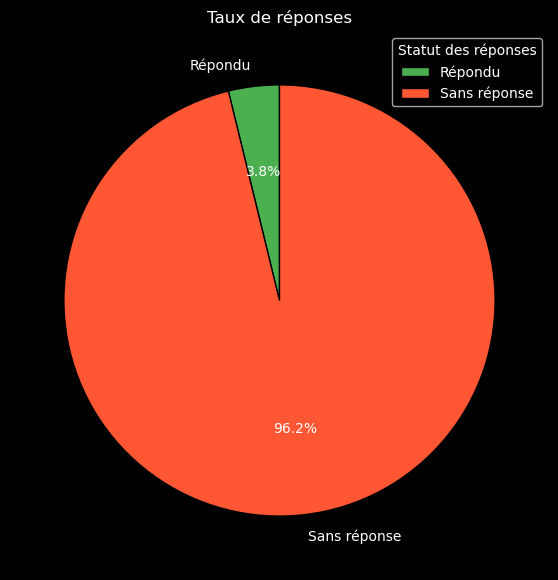

Fichier JSON 'reponses_stats.json' généré avec succès.


In [3]:
# Diagramme circulaire des réponses

# Compter les réponses non vides
total_lignes = len(df)


# Nombre total de réponses

# Espaces ayant répondu à au moins une question
espaces_ayant_repondu = len(df[(df['réponse1'].notna()) | (df['réponse2'].notna())])
# Espaces n'ayant répondu à aucune question
espaces_sans_reponse = total_lignes - espaces_ayant_repondu

# Création du dictionnaire avec les valeurs
data = {
    "Répondu": int(espaces_ayant_repondu),
    "Sans réponse": int(espaces_sans_reponse)
}


# Données pour le diagramme
labels = ['Répondu', 'Sans réponse']
values = [espaces_ayant_repondu, espaces_sans_reponse]  # Calculs des réponses
colors = ['#4CAF50', '#FF5733']  # Couleurs pour les sections

# Création du pie chart
plt.figure(figsize=(7,7))
wedges, texts, autotexts = plt.pie(values, labels=labels, autopct='%1.1f%%', 
                                    colors=colors, startangle=90, wedgeprops={'edgecolor': 'black'})

# Ajouter un titre
plt.title("Taux de réponses")

# Ajouter la légende
plt.legend(wedges, labels, title="Statut des réponses", loc="best")

# Afficher le graphique
plt.show()

# Sauvegarde en fichier JSON
with open("reponses_stats.json", "w", encoding="utf-8") as f:
    json.dump(data, f, ensure_ascii=False, indent=4)

print("Fichier JSON 'reponses_stats.json' généré avec succès.")


In [4]:
df.columns

Index(['id', 'nom', 'date_ouverture', 'date_fermeture', 'website', 'email',
       'adresse', 'horaires', 'presentation', 'responsables', 'historique',
       'activites', 'expositions', 'publications', 'events', 'residences',
       'workshop', 'archive', 'librairie', 'coworking', 'education',
       'nb_expos_an', 'nb_artistes_an', 'partenaires', 'created_at',
       'updated_at', 'slug', 'pays', 'ville', 'latitude', 'longitude',
       'adresse_complete', 'codepostal', 'telephone', 'visite', 'user_id',
       'question1', 'réponse1', 'question2', 'réponse2'],
      dtype='object')

In [5]:
def clean_text(text):
    if pd.isna(text):
        return ""
    
    # Convertir en string
    text = str(text)
    
    # Nettoyer les marqueurs de retour à la ligne spécifiques
    text = text.replace('_*x000d*_', ' ')
    
    # Nettoyer les espaces multiples
    text = ' '.join(text.split())
    
    return text.strip()

def combine_columns(row):
    """Combine les colonnes de texte pour un espace donné sans les labels."""
    combined_text = []
    for content_type in ['activites', 'presentation', 'historique', 'réponse1', 'réponse2']:
        content = row[content_type]
        if pd.notna(content) and str(content).strip() != "":
            cleaned_text = clean_text(content)
            combined_text.append(cleaned_text)
    return " ".join(combined_text)  # Fusionner sans séparateur explicite


# Combiner les colonnes de texte pour chaque espace
df['texte_combine'] = df.apply(combine_columns, axis=1)
df_combine = df[['nom', 'texte_combine']]

# Afficher quelques exemples de texte combiné
print("\nExemples de texte combiné :")
print(df_combine[['nom', 'texte_combine']].head(10))

df_combine[['nom', 'texte_combine']].to_csv("output.csv", index=False, encoding='utf-8')
print("Fichier 'output.csv' généré.")






Exemples de texte combiné :
                        nom                                      texte_combine
0                   La loge                                                   
1                         W  W was installed in the East of Paris, in Panti...
2                     HEKLA                                                   
3                 Rosa Brux                                                   
4        Greylight Projects                                                   
5                HECTOLITER  H E C T O L I T E R is a project space for con...
6  Artists Club Coffre-Fort  In March 2012, Thibaut Espiau, Ištvan Išt Huzj...
7                      / 77  All of the activities that we will develop and...
8                    Island  Island is a non profit art space, opened in 20...
9                 Immanence  Immantique is a place of exhibition, diffusion...
Fichier 'output.csv' généré.


In [6]:


def load_and_prepare_data(df):
    processed_texts = []
    space_names = []
    
    for idx, row in df.iterrows():
        content = row['texte_combine']  # Utilisation directe de la colonne fusionnée
        if pd.notna(content) and str(content).strip() != "":
            # Nettoyer le texte
            cleaned_text = clean_text(content)
            
            # Vérifier si le texte n'est pas vide après nettoyage
            if cleaned_text:
                processed_texts.append(cleaned_text)
                space_names.append(str(row['nom']).strip())

    # Créer le DataFrame
    processed_df = pd.DataFrame({
        'nom': space_names,
        'texte': processed_texts
    })
    
    # Afficher les statistiques
    print("Statistiques :")
    print(f"Nombre total de documents : {len(processed_df)}")
    print("\nNombre d'espaces uniques :", len(processed_df['nom'].unique()))
    
    # Afficher quelques exemples pour vérification
    print("\nExemples de textes nettoyés :")
    print(processed_df['texte'].iloc[0][:200])  # Premier extrait de texte
    
    return processed_df

# Préparer les données
processed_df = load_and_prepare_data(df_combine)


Statistiques :
Nombre total de documents : 330

Nombre d'espaces uniques : 330

Exemples de textes nettoyés :
W was installed in the East of Paris, in Pantin in February 2010. The space has two very different potentials: the first level is an abbreviation space, the second working space. W aims at the quality


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/jadjimon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


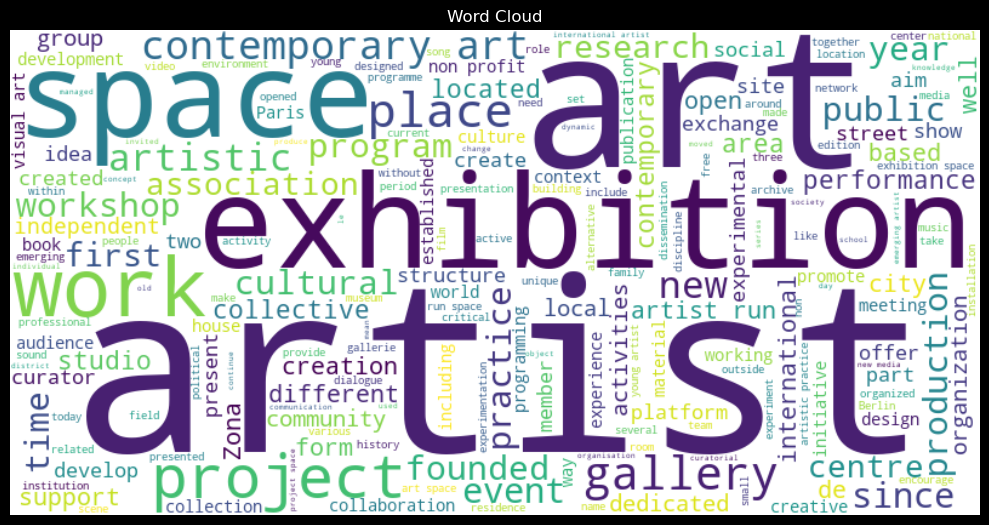

Word cloud saved as 'word_cloud.png'


In [7]:
# Nuage de mots enregistrer 
# Création d'un nuage de mots à partir des textes en anglais
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk

# Télécharger les stopwords anglais si ce n'est pas déjà fait
nltk.download('stopwords')

# Concaténer tous les textes en un seul grand texte
all_text = ' '.join(processed_df['texte'])

# Définir les stopwords (mots vides) en anglais à ignorer
english_stopwords = set(stopwords.words('english'))
# Ajouter d'autres mots non pertinents si nécessaire
custom_stopwords = {'also', 'would', 'could', 'one', 'may', 'many', 'use'}
all_stopwords = english_stopwords.union(custom_stopwords)

# Créer le nuage de mots
wordcloud = WordCloud(
    width=800, 
    height=400, 
    background_color='white',
    stopwords=all_stopwords,
    contour_width=1,
    contour_color='steelblue',
    colormap='viridis',
    random_state=42  # Pour la reproductibilité
).generate(all_text)

# Afficher le nuage de mots
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud")
plt.tight_layout()
plt.show()

# Sauvegarder l'image
wordcloud.to_file("word_cloud.png")
print("Word cloud saved as 'word_cloud.png'")

In [8]:
df_combine.columns


Index(['nom', 'texte_combine'], dtype='object')

In [9]:
processed_df.columns

Index(['nom', 'texte'], dtype='object')

In [10]:
# Créer un nouveau DataFrame avec les colonnes souhaitées de la base de départ
df_final = df[['nom', 'latitude', 'longitude', 'ville', 'pays', 'website']].copy()

# Ajouter une colonne 'texte' vide
df_final['texte'] = ""

# Pour chaque espace dans processed_df, ajouter son texte dans df_final
for _, row in processed_df.iterrows():
    mask = df_final['nom'] == row['nom']
    if any(mask):
        df_final.loc[mask, 'texte'] = row['texte']

# Afficher quelques statistiques pour vérification
print("\nStatistiques:")
print(f"Nombre total d'espaces dans df_final: {len(df_final)}")
print(f"Nombre d'espaces avec texte: {len(df_final[df_final['texte'] != ''])}")
print(f"Nombre d'espaces sans texte: {len(df_final[df_final['texte'] == ''])}")

# Maintenant on peut créer le JSON à partir de df_final
def create_geo_json(df_final):
    """
    Crée le fichier JSON avec les coordonnées des espaces et leurs textes
    """
    geo_data = []
    total_spaces = len(df_final)
    spaces_without_coords = 0
    
    for _, space_info in df_final.iterrows():
        try:
            if pd.notna(space_info['latitude']) and pd.notna(space_info['longitude']):
                space_object = {
                    "nom": str(space_info['nom']).strip(),
                    "latitude": float(space_info['latitude']),
                    "longitude": float(space_info['longitude']),
                    "ville": str(space_info['ville']) if pd.notna(space_info['ville']) else "",
                    "pays": str(space_info['pays']) if pd.notna(space_info['pays']) else "",
                    "website": str(space_info['website']) if pd.notna(space_info['website']) else "",
                    "texte": str(space_info['texte']).strip()
                }
                geo_data.append(space_object)
            else:
                print(f"Avertissement: Coordonnées manquantes pour '{space_info['nom']}'")
                spaces_without_coords += 1
        except (ValueError, TypeError) as e:
            print(f"Erreur avec les coordonnées de '{space_info['nom']}': {e}")
            spaces_without_coords += 1
    
    # Afficher les statistiques
    print(f"\nStatistiques de géolocalisation:")
    print(f"Nombre total d'espaces: {total_spaces}")
    print(f"Espaces sans coordonnées valides: {spaces_without_coords}")
    print(f"Espaces avec coordonnées valides: {len(geo_data)}")
    
    # Afficher la répartition par pays
    if geo_data:
        pays_count = {}
        for space in geo_data:
            if space['pays']:
                pays_count[space['pays']] = pays_count.get(space['pays'], 0) + 1
        print("\nRépartition par pays:")
        for pays, count in sorted(pays_count.items()):
            print(f"{pays}: {count} espaces")
    
    # Sauvegarder en JSON
    if geo_data:
        with open('data.json', 'w', encoding='utf-8') as f:
            json.dump(geo_data, f, ensure_ascii=False, indent=2)
        print(f"\nFichier JSON créé avec succès.")
        
        # Afficher quelques exemples
        print("\nExemples d'entrées du fichier JSON:")
        for entry in geo_data[:3]:
            print(json.dumps(entry, ensure_ascii=False, indent=2))
    
    return geo_data

# Créer le fichier JSON
import json
try:
    geo_data = create_geo_json(df_final)
except Exception as e:
    print(f"Erreur lors de la création du fichier JSON: {e}")
    import traceback
    traceback.print_exc()


Statistiques:
Nombre total d'espaces dans df_final: 341
Nombre d'espaces avec texte: 318
Nombre d'espaces sans texte: 23
Avertissement: Coordonnées manquantes pour 'L'épicerie'
Avertissement: Coordonnées manquantes pour 'PeepSpace'
Avertissement: Coordonnées manquantes pour 'Kurt-forever'
Avertissement: Coordonnées manquantes pour 'Palais des paris'
Avertissement: Coordonnées manquantes pour 'GLASSBOX-NORD'

Statistiques de géolocalisation:
Nombre total d'espaces: 341
Espaces sans coordonnées valides: 5
Espaces avec coordonnées valides: 336

Répartition par pays:
Albanie: 2 espaces
Allemagne: 37 espaces
Australia: 6 espaces
Austria: 2 espaces
Azerbaijan: 1 espaces
Belgique: 25 espaces
Bosnia And Herzegovina: 1 espaces
Brésil: 1 espaces
Bulgaria: 2 espaces
Canada: 29 espaces
Chile: 2 espaces
Chine: 3 espaces
Colombia: 1 espaces
Cyprus: 2 espaces
Danemark: 1 espaces
Egypt: 2 espaces
España: 6 espaces
France: 112 espaces
Georgia: 2 espaces
Grèce: 3 espaces
Hungary: 4 espaces
Inde: 1 espa

In [11]:
print(processed_df.head())

                        nom                                              texte
0                         W  W was installed in the East of Paris, in Panti...
1                HECTOLITER  H E C T O L I T E R is a project space for con...
2  Artists Club Coffre-Fort  In March 2012, Thibaut Espiau, Ištvan Išt Huzj...
3                      / 77  All of the activities that we will develop and...
4                    Island  Island is a non profit art space, opened in 20...


# Implémentation du modèle

# KeyBERTInspired + MMR

# Ollama mistral

# Approche hybride 

- KeyBERTInspired + MMR pour extraire des mots-clés représentant les topics (structure analytique). 
- Passer les textes associés à chaque topic à Mistral Small 3.1 pour générer une phrase descriptive pour chaque topic (présentation narrative).
- Produire une sortie combinée qui inclut à la fois les mots-clés et les résumés narratifs pour chaque topic.


In [11]:
import pandas as pd
import numpy as np
import json
import re
import time
import asyncio
import pickle
import os
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance
from sklearn.feature_extraction.text import CountVectorizer
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
import openai
from openai import AsyncOpenAI

# Define custom stop words (réduite pour préserver des termes clés)
custom_stop_words = list(ENGLISH_STOP_WORDS) + [
    'the', 'a', 'an', 'les', 'la', 'le', 'les', 'des',
    'and', 'or', 'but', 'et', 'ou', 'mais',
    'in', 'on', 'at', 'to', 'for', 'of', 'with', 'by', 'from',
    'dans', 'sur', 'pour', 'de', 'par',
    'it', 'its', 'this', 'that', 'these', 'those',
    'il', 'elle', 'ils', 'elles', 'ce', 'cette', 'ces',
    'is', 'are', 'was', 'were', 'be', 'been', 'being',
    'est', 'sont', 'être',
    'etc', 'eg', 'ie', 'cf',
    'x000d', 'www', 'http', 'https',
    'extra', 'certain',
    'located', 'large', 'small',
    'old', 'new',
    'time', 'year',
    'team',
    'place', 'site',
    'run', 'open',
    'hours', 'offers', 'general', 'point', 'white',
    'saint', 'island', 'village', 'printmaking'
]

# Define text cleaning functions
def clean_word(word):
    word = word.lower()
    if 'http' in word or 'www' in word:
        return ""
    word = re.sub(r'x000d|x0002', '', word, flags=re.IGNORECASE)
    word = re.sub(r'[\r\n\t]', ' ', word)
    word = word.replace('_', ' ')
    word = re.sub(r'\b\d{1,3}\b', '', word)  # Supprime les nombres sauf les années
    word = re.sub(r'[^\w\s]', ' ', word)
    word = ' '.join(word.split())
    if (word.lower() in custom_stop_words or len(word) <= 2):
        return ""
    return word

def preprocess_text(text):
    if not isinstance(text, str):
        return ""
    text = text.lower()
    text = re.sub(r'http\S+|www\.\S+', '', text)
    text = re.sub(r'x000d|x0002', '', text, flags=re.IGNORECASE)
    text = re.sub(r'[\r\n\t]', ' ', text)
    text = re.sub(r'_+', ' ', text)
    text = re.sub(r'\b\d{1,3}\b', '', text)  # Supprime les nombres sauf les années (4 chiffres)
    text = re.sub(r'[^\w\s]', ' ', text)
    text = re.sub(r'\s+', ' ', text)
    # Normaliser les noms propres (exemple simple)
    text = re.sub(r'\b(quellcollectiv|khiasma|borgo ensemble|irmavep|artpool|autocenter|west space|datazone|immantique|h+ gallery|poctb|station mir|g39|rémy lielo|hannah théveneau|street gallery|franklin furnace|zabriskie point|general public|yarat|artellewa|ugo carrega|sea foundation|duplex100m2|place common|tilde|arprim|loop|para site|white columns|40mcube|articule|poisson river centre|printed matter|number shop|zeta|castillo corrales|edel extra|221a)\b', 'ART_ORG', text)
    text = re.sub(r'\b(after hours|fruithouse)\b', 'ART_ORG', text)
    text = re.sub(r'\b(nuremberg|lilas|paris|spain|berlin|châtillon|balatonboglár|lebanese|orléans)\b', 'CITY', text)
    text = re.sub(r'\b(salaisons|lower space|saint paul trois châteaus)\b', 'ART_ORG', text)
    words = text.split()
    words = [w for w in words if w not in custom_stop_words and len(w) > 2]
    return ' '.join(words).strip()

def clean_topic_names(topic_model):
    cleaned_topics = {}
    for topic_id, topic_info in topic_model.get_topics().items():
        seen_words = set()
        cleaned_words = []
        for word, score in topic_info:
            cleaned_word = clean_word(word)
            if cleaned_word and cleaned_word.lower() not in seen_words:
                words_in_phrase = set(cleaned_word.lower().split())
                if not words_in_phrase.intersection(seen_words):
                    if score > 0.01:
                        cleaned_words.append((cleaned_word, score))
                        seen_words.update(words_in_phrase)
        cleaned_topics[topic_id] = cleaned_words[:5]
    return cleaned_topics

# Load and preprocess data
# Replace with your data loading logic, e.g., processed_df = pd.read_csv('your_data.csv')
processed_df['processed_text'] = processed_df['texte'].apply(preprocess_text)
processed_df['word_count'] = processed_df['processed_text'].apply(lambda x: len(x.split()))
processed_df = processed_df[processed_df['word_count'] >= 20].copy()  # Increased from 5 to 10
print(f"Nombre de documents après filtrage (longueur >= 20 mots) : {len(processed_df)}")
docs = processed_df['processed_text'].tolist()

# Cache embeddings
embedding_model = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2')
embedding_cache_file = 'embeddings_cache.pkl'
if os.path.exists(embedding_cache_file):
    with open(embedding_cache_file, 'rb') as f:
        embeddings = pickle.load(f)
else:
    embeddings = embedding_model.encode(docs, show_progress_bar=True)
    with open(embedding_cache_file, 'wb') as f:
        pickle.dump(embeddings, f)

# Step 1: Configure BERTopic with KeyBERTInspired + MMR
representation_model_keybert = {
    "main": KeyBERTInspired(top_n_words=15),
    "mmr": MaximalMarginalRelevance(diversity=0.5)
}

umap_model = UMAP(
    n_neighbors=8,  # Reduced from 30 to 15
    n_components=5,
    min_dist=0.0,
    metric='cosine',
    random_state=42
)
hdbscan_model = HDBSCAN(
    min_cluster_size=2,  # Reduced from 3 to 2
    min_samples=1,  # Reduced from 2 to 1
    metric='euclidean',
    cluster_selection_method='eom',
    prediction_data=True
)
vectorizer_model = CountVectorizer(
    stop_words=custom_stop_words,
    ngram_range=(1, 3),
    preprocessor=preprocess_text,
    min_df=3,
    max_df=0.70,
    token_pattern=r'(?u)\b[a-zA-Z]{3,}\b'
)

topic_model_keybert = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    representation_model=representation_model_keybert,
    min_topic_size=2,  # Aligned with min_cluster_size
    top_n_words=10,
    calculate_probabilities=True,
    verbose=True
)

# Train KeyBERTInspired model
topics_keybert, probs_keybert = topic_model_keybert.fit_transform(docs, embeddings=embeddings)
topic_model_keybert.reduce_topics(docs, nr_topics="auto")
cleaned_topics_keybert = clean_topic_names(topic_model_keybert)

# Add KeyBERT results to DataFrame
processed_df['topic_keybert'] = topics_keybert
processed_df['topic_probability_keybert'] = np.max(probs_keybert, axis=1) if isinstance(probs_keybert, np.ndarray) else 1.0

# Step 2: Group texts by topic for Mistral summarization
topic_texts = {}
for topic_id in set(topics_keybert):
    if topic_id != -1:  # Exclude outliers
        topic_docs = processed_df[processed_df['topic_keybert'] == topic_id]['texte'].tolist()
        topic_texts[topic_id] = " ".join(topic_docs[:1000])[:2000]  # Limit text length for API

# Step 3: Configure Mistral Small 3.1 client and generate summaries
prompt = "Summarize the main theme in one concise sentence (max 15 words), avoiding specific names, places, and vague regional references:"

async def generate_summary(client, topic_id, text, prompt, max_attempts=3):
    for attempt in range(max_attempts):
        try:
            response = await client.chat.completions.create(
                model='mistral-small3.1:latest',
                messages=[
                    {"role": "system", "content": prompt},
                    {"role": "user", "content": text}
                ],
                max_tokens=15,
                temperature=0.3
            )
            return topic_id, response.choices[0].message.content.strip()
        except Exception as e:
            if attempt < max_attempts - 1:
                print(f"Tentative {attempt+1} échouée pour topic {topic_id}: {e}. Nouvelle tentative après {2**(attempt+1)}s...")
                await asyncio.sleep(2**(attempt+1))
            else:
                print(f"Échec après {max_attempts} tentatives pour topic {topic_id}: {e}")
                return topic_id, "No summary available due to API error."

async def generate_all_summaries(topic_texts, prompt):
    async with AsyncOpenAI(base_url='http://localhost:11434/v1', api_key='ollama') as client:
        tasks = []
        for topic_id, text in topic_texts.items():
            if text.strip():
                tasks.append(generate_summary(client, topic_id, text, prompt))
            else:
                tasks.append(asyncio.sleep(0, result=(topic_id, "No summary available due to insufficient text.")))
        results = await asyncio.gather(*tasks, return_exceptions=True)
        return dict(results)

# Exécuter dans Jupyter Notebook avec await
topic_summaries = await generate_all_summaries(topic_texts, prompt)

# Step 4: Combine results
hybrid_results = {}
for topic_id in cleaned_topics_keybert:
    if topic_id != -1:
        keywords = [word for word, _ in cleaned_topics_keybert[topic_id]]
        summary = topic_summaries.get(topic_id, "No summary generated.")
        hybrid_results[topic_id] = {
            "keywords": keywords,
            "summary": summary
        }

# Display results
print("\n=== Hybrid Pipeline Results ===")
for topic_id, result in hybrid_results.items():
    print(f"\nTopic {topic_id}:")
    print(f"Keywords: {', '.join(result['keywords'])}")
    print(f"Summary: {result['summary']}")

# Save results to JSON
with open('hybrid_topics.json', 'w', encoding='utf-8') as f:
    json.dump(hybrid_results, f, ensure_ascii=False, indent=4)
print("\nHybrid topics (keywords + summaries) saved to 'hybrid_topics.json'.")

# Générer un dictionnaire avec le nombre de documents par topic
topic_counts = {}
for topic in set(topics_keybert):
    if topic != -1:  # Exclure les outliers
        count = len(processed_df[processed_df['topic_keybert'] == topic])
        topic_counts[str(topic)] = {"texte": count}

# Sauvegarder au format JSON
with open('topic_analysis.json', 'w', encoding='utf-8') as f:
    json.dump(topic_counts, f, ensure_ascii=False, indent=4)
print("Nombre de documents par topic sauvegardé dans 'topic_analysis.json'.")

# Analyze topic -1
topic_info_keybert = topic_model_keybert.get_topic_info()
if -1 in topic_info_keybert['Topic'].values:
    topic_minus_1_count = topic_info_keybert[topic_info_keybert['Topic'] == -1]['Count'].iloc[0]
    print(f"\nPourcentage de documents dans le topic -1 : {(topic_minus_1_count / len(processed_df) * 100):.2f}%")
    topic_minus_1_docs = processed_df[processed_df['topic_keybert'] == -1][['texte', 'processed_text']].head(5)
    print("Exemples de documents dans le topic -1 :")
    for i, row in topic_minus_1_docs.iterrows():
        print(f"Document {i+1}: {row['texte'][:200]}... (Pré-traité: {row['processed_text'][:100]}...)")
    processed_df[processed_df['topic_keybert'] == -1][['texte', 'processed_text']].to_csv('topic_minus_1_hybrid.csv', index=False)
    print("Documents du topic -1 exportés dans 'topic_minus_1_hybrid.csv'.")
else:
    print("\nAucun document dans le topic -1.")

# Visualize topics
print("\nTopic Information:")
print(topic_info_keybert)

Nombre de documents après filtrage (longueur >= 20 mots) : 307


2025-05-10 09:58:48,631 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-05-10 09:58:55,528 - BERTopic - Dimensionality - Completed ✓
2025-05-10 09:58:55,530 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-05-10 09:58:55,697 - BERTopic - Cluster - Completed ✓
2025-05-10 09:58:55,706 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-05-10 09:59:01,821 - BERTopic - Representation - Completed ✓
2025-05-10 09:59:02,185 - BERTopic - Topic reduction - Reducing number of topics
2025-05-10 09:59:02,204 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-05-10 09:59:04,923 - BERTopic - Representation - Completed ✓
2025-05-10 09:59:04,925 - BERTopic - Topic reduction - Reduced number of topics from 97 to 69



=== Hybrid Pipeline Results ===

Topic 0:
Keywords: art org, projects, arts
Summary: Artistic collaboration and open expression foster creativity and community engagement.

Topic 1:
Keywords: pierre, mainly, spaces art, steps, italy
Summary: Artists and creatives collaborate to engage communities through cultural initiatives.

Topic 2:
Keywords: century, paintings, museum, concrete, houses
Summary: Artists create and showcase innovative work in community-driven, non-commercial spaces

Topic 3:
Keywords: fashion, press, poetry, took, presented
Summary: Artists collaborate to create and promote experimental contemporary art and community engagement.

Topic 4:
Keywords: popular, going, editions, narrative, submissions
Summary: Collaboration and experimentation foster artistic growth and community.

Topic 5:
Keywords: club, brussels, stone, wood, group
Summary: Art institutions evolve to foster global artistic dialogue and critical societal understanding.

Topic 6:
Keywords: artists space

# Présentation des résultats 

In [39]:
def evaluate_topic_quality(topic_model, cleaned_topics, texts):
    # Obtenir les mots-clés nettoyés de chaque topic
    topic_words = cleaned_topics
    
    # Vérifier la diversité des topics
    unique_words = set()
    total_words = 0
    
    for topic in topic_words.values():
        words = [word for word, _ in topic]  # Extraire les mots-clés
        unique_words.update(words)
        total_words += len(words)
    
    topic_diversity = len(unique_words) / total_words if total_words > 0 else 0  # Normalisation correcte
    
    # Calculer la représentativité des topics
    topic_sizes = topic_model.get_topic_freq()
    topic_sizes = topic_sizes[topic_sizes["Topic"] != -1]  # Exclure les outliers
    
    topic_coverage = (len(texts) - topic_sizes["Count"].sum()) / len(texts) if not topic_sizes.empty else 0
    
    print("\n=== ÉVALUATION DES TOPICS ===")
    print(f"Diversité des topics : {topic_diversity:.3f} (idéalement proche de 1)")
    print(f"Couverture des topics : {topic_coverage:.3f} (idéalement proche de 0)")
    
    return {"topic_diversity": topic_diversity, "topic_coverage": topic_coverage}

# Appel de la fonction
quality_metrics = evaluate_topic_quality(topic_model_keybert, cleaned_topics_keybert, processed_df['texte'].tolist())

# Sauvegarder les métriques pour l'application React (facultatif)
with open('quality_metrics.json', 'w', encoding='utf-8') as f:
    json.dump(quality_metrics, f, ensure_ascii=False, indent=4)
print("Métriques de qualité sauvegardées dans 'quality_metrics.json'.")




=== ÉVALUATION DES TOPICS ===
Diversité des topics : 0.913 (idéalement proche de 1)
Couverture des topics : 0.101 (idéalement proche de 0)
Métriques de qualité sauvegardées dans 'quality_metrics.json'.


- Diversité des topics : 0.913 ✅ → C’est une bonne valeur, proche de 1, ce qui signifie que Les topics sont très distincts et variés, avec une redondance minimale. Cette valeur est proche de l'idéal (1), confirmant la qualité de votre modèle pour une analyse fine.
- Couverture des topics : 0.101 ✅ → Idéalement, on voudrait que ça soit plus bas (proche de 0) ou inférieur à 10%, ce qui signifierait que la majorité des textes sont bien couverts par les topics. La valeur 0,101 signifie que 89,9 % des textes sont bien couverts par les 68 topics, ce qui répresente un succès adapté à une analyse fine.


In [14]:
print("IDs de topics uniques dans processed_df['topic_keybert'] :", sorted(processed_df['topic_keybert'].unique()))
print("Nombre total de topics uniques dans processed_df['topic_keybert'] (hors -1) :", len(processed_df[processed_df['topic_keybert'] != -1]['topic_keybert'].unique()))

IDs de topics uniques dans processed_df['topic_keybert'] : [-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95]
Nombre total de topics uniques dans processed_df['topic_keybert'] (hors -1) : 96


In [16]:
print("Nombre de documents par topic dans processed_df :")
print(processed_df['topic_keybert'].value_counts())

Nombre de documents par topic dans processed_df :
topic_keybert
 0     87
-1     36
 1      8
 2      5
 3      5
       ..
 66     2
 67     2
 68     2
 69     2
 70     2
Name: count, Length: 72, dtype: int64


In [25]:
import pandas as pd
import json
import plotly.express as px

# Section 5 : Analyse des Relations entre Topics
###########################################

print("\n=== Analyse des Relations entre Topics ===")

# Vérifier les objets nécessaires
if 'processed_df' not in globals() or 'topic_model_keybert' not in globals():
    raise NameError("Erreur : processed_df ou topic_model_keybert non définis. Exécutez le pipeline principal d'abord.")

# Définir cleaned_topics_keybert si non fourni (utiliser le modèle)
cleaned_topics_keybert = topic_model_keybert.get_topics()

# Définir manuellement les topics valides basés sur la sortie initiale (0 à 67)
valid_topics = list(range(68))  # [0, 1, 2, ..., 67]
print(f"Topics valides dans le modèle (hors -1) : {valid_topics}")

# Vérifier et corriger processed_df['topic_keybert']
print("Vérification des topics dans processed_df...")
current_topics = sorted(processed_df['topic_keybert'].unique())
print(f"Topics uniques dans processed_df : {current_topics}")

# Corriger les IDs invalides (68-70) en -1
if set(current_topics) - set(valid_topics + [-1]):
    print("Correction des IDs invalides (68-70) en -1...")
    processed_df['topic_keybert'] = processed_df['topic_keybert'].apply(
        lambda x: x if x in valid_topics + [-1] else -1
    )
    print("Topics corrigés :", sorted(processed_df['topic_keybert'].unique()))

# Vérifier le nombre de documents par topic après correction
print("Nombre de documents par topic dans processed_df après correction :")
print(processed_df['topic_keybert'].value_counts())

# 1. Analyse des relations entre topics
def analyze_topic_relationships(df, cleaned_topics):
    print("\nAnalyse détaillée des topics :")
    for topic in sorted(df['topic_keybert'].unique()):
        if topic != -1 and topic in cleaned_topics:
            print(f"\nTopic {topic}:")
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:5]
            print(f"Mots-clés: {', '.join(keywords)}")
            print("Exemples d'espaces contribuant à ce topic :")
            examples = df[df['topic_keybert'] == topic]['nom'].head(3).tolist()
            if examples:
                print(", ".join(examples))
            else:
                print("Aucun espace disponible.")

# 2. Création d'une visualisation interactive (Sunburst avec noms au survol)
def create_interactive_topic_mapping(df, cleaned_topics):
    topic_data = []
    
    # Stocker les données pour le fichier JSON des associations topics-espaces
    topics_spaces_data = {}
    
    for topic in sorted(df['topic_keybert'].unique()):
        if topic != -1 and topic in cleaned_topics:
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:3]
            topic_docs = df[df['topic_keybert'] == topic]
            spaces = topic_docs['nom'].head(5).tolist()  # Augmenté à 5 espaces par topic
            
            # Stocker les espaces pour ce topic
            topics_spaces_data[str(topic)] = spaces
            
            topic_data.append({
                'Topic': f"Topic {topic}",
                'Count': len(topic_docs),
                'Keywords': ', '.join(keywords),
                'Spaces': ', '.join(spaces) if spaces else "Aucun espace"
            })
    
    # Enregistrer les associations topics-espaces dans un fichier JSON
    with open('topics_spaces.json', 'w', encoding='utf-8') as f:
        json.dump(topics_spaces_data, f, ensure_ascii=False, indent=4)
    print("Associations topics-espaces sauvegardées dans 'topics_spaces.json'.")
    
    topic_df = pd.DataFrame(topic_data)
    # Vérifier les données avant le graphique
    print("\nDonnées pour le Sunburst :")
    print(topic_df[['Topic', 'Count', 'Keywords', 'Spaces']])
    
    fig = px.sunburst(
        topic_df,
        path=['Topic'],
        values='Count',
        hover_data=['Keywords', 'Spaces'],
        width=500,
        height=500
    )
    fig.update_layout(
        title="Mapping des Topics",
        legend_title="Topic ID",
        legend=dict(x=0.85, y=0.85)
    )
    fig.write_html("topic_mapping.html")
    print("Graphique Sunburst sauvegardé dans 'topic_mapping.html'.")
    return fig

# 3. Préparer le fichier d'analyse des topics complet
def save_topic_analysis(df, cleaned_topics, hybrid_topics=None):
    # Calculer le nombre de documents par topic
    topic_counts = df.groupby('topic_keybert').size().reset_index(name='Count')
    topic_counts = topic_counts[topic_counts['topic_keybert'] != -1]
    
    # Préparation des données pour le fichier topic_analysis.json
    topic_analysis = {}
    for _, row in topic_counts.iterrows():
        topic_id = int(row['topic_keybert'])
        topic_analysis[str(topic_id)] = {
            'texte': int(row['Count'])
        }
    
    # Sauvegarder le fichier topic_analysis.json (plus simple)
    with open('topic_analysis.json', 'w', encoding='utf-8') as f:
        json.dump(topic_analysis, f, ensure_ascii=False, indent=4)
    print("Analyse des topics (comptages) sauvegardée dans 'topic_analysis.json'.")
    
    # Préparer aussi un fichier Excel plus détaillé (optionnel)
    data = []
    for _, row in topic_counts.iterrows():
        topic = int(row['topic_keybert'])
        if topic in cleaned_topics:
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:5]
            summary = hybrid_topics.get(str(topic), {}).get("summary", "Pas de résumé disponible") if hybrid_topics else "Pas de résumé disponible"
            
            # Récupérer les espaces liés à ce topic
            topic_spaces = df[df['topic_keybert'] == topic]['nom'].head(3).tolist()
            
            data.append({
                'Topic': topic,
                'Count': row['Count'],
                'Keywords': ', '.join(keywords),
                'Summary': summary,
                'Spaces': ', '.join(topic_spaces) if topic_spaces else "Aucun espace"
            })
    
    df_analysis = pd.DataFrame(data)
    output_file = 'topic_analysis_details.xlsx'
    df_analysis.to_excel(output_file, index=False, engine='openpyxl')
    print(f"Analyse détaillée des topics sauvegardée dans '{output_file}'.")

# 4. Exécuter les analyses
try:
    # Charger les résumés de topics s'ils existent
    hybrid_topics = None
    try:
        with open('hybrid_topics.json', 'r', encoding='utf-8') as f:
            hybrid_topics = json.load(f)
        print("Fichier hybrid_topics.json chargé avec succès.")
    except Exception as e:
        print(f"Impossible de charger hybrid_topics.json: {e}")
    
    analyze_topic_relationships(processed_df, cleaned_topics_keybert)
    fig = create_interactive_topic_mapping(processed_df, cleaned_topics_keybert)
    save_topic_analysis(processed_df, cleaned_topics_keybert, hybrid_topics)
except Exception as e:
    print(f"Erreur lors de l'exécution : {e}")

# Afficher le graphique Sunburst (optionnel dans Jupyter)
fig.show()


=== Analyse des Relations entre Topics ===
Topics valides dans le modèle (hors -1) : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67]
Vérification des topics dans processed_df...
Topics uniques dans processed_df : [-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67]
Nombre de documents par topic dans processed_df après correction :
topic_keybert
 0     87
-1     42
 1      8
 3      5
 4      5
       ..
 44     2
 45     2
 46     2
 47     2
 34     2
Name: count, Length: 69, dtype: int64
Fichier hybrid_topics.json chargé avec succès.

Analyse détaillée des topic

Graphique interactif :
Le graphique interactif de type Sunburst te permet de visualiser la répartition des topics dans tes données, avec des informations sur le nombre de documents par topic et les mots-clés associés.

In [ ]:
print(processed_df.columns)


In [22]:
import pandas as pd
import plotly
from bertopic import BERTopic

# Section 4 : Visualisations Interactives
print("\n=== Visualisations Interactives ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les données
print("Vérification des données :")
print(f"Nombre de documents dans processed_df: {len(processed_df)}")
print(f"Nombre de topics dans topic_model_keybert: {len(topic_model_keybert.topics_)}")
print(f"Valeurs manquantes dans processed_df['texte']: {processed_df['texte'].isna().sum()}")

# Aligner les indices
processed_df = processed_df.reset_index(drop=True)

# 1. Intertopic Distance Map
print("Génération de la carte des distances entre topics...")
topic_viz = topic_model_keybert.visualize_topics(
    title="Carte des Distances entre Topics",
    width=800,
    height=600
)
topic_viz.show()
topic_viz.write_html("intertopic_distance_map.html")
print("Sauvegardé dans 'intertopic_distance_map.html'.")
topic_data = topic_model_keybert.get_topic_info()[['Topic', 'Count', 'Name']]
topic_data.to_json("intertopic_distance_data.json", orient='records', indent=4)
print("Données sauvegardées dans 'intertopic_distance_data.json'.")

# 2. Topic Hierarchy
print("Génération de la hiérarchie des topics...")
hierarchy_viz = topic_model_keybert.visualize_hierarchy(
    title="Hiérarchie des Topics",
    width=800,
    height=600
)
hierarchy_viz.show()
hierarchy_viz.write_html("topic_hierarchy.html")
print("Sauvegardé dans 'topic_hierarchy.html'.")

# 3. Topic Distribution
print("Génération de la distribution des topics...")
barchart_viz = topic_model_keybert.visualize_barchart(
    top_n_topics=20,
    title="Distribution des Mots-clés par Topic",
    width=800,
    height=600
)
barchart_viz.show()
barchart_viz.write_html("topic_distribution.html")
print("Sauvegardé dans 'topic_distribution.html'.")

# 4. Heatmap des similarités entre topics (remplacement)
print("Génération de la heatmap des similarités entre topics...")
heatmap_viz = topic_model_keybert.visualize_heatmap(
    #n_clusters=5,  # Regrouper les topics en 5 clusters pour plus de lisibilité
    #top_n_topics=20,  # Limiter à 20 topics (ajuster si nécessaire)
    title="Similarité entre Topics",
    width=800,
    height=600
)
heatmap_viz.show()
heatmap_viz.write_html("topic_similarity_heatmap.html")
print("Sauvegardé dans 'topic_similarity_heatmap.html'.")



=== Visualisations Interactives ===
Vérification des données :
Nombre de documents dans processed_df: 307
Nombre de topics dans topic_model_keybert: 307
Valeurs manquantes dans processed_df['texte']: 0
Génération de la carte des distances entre topics...


Sauvegardé dans 'intertopic_distance_map.html'.
Données sauvegardées dans 'intertopic_distance_data.json'.
Génération de la hiérarchie des topics...


Sauvegardé dans 'topic_hierarchy.html'.
Génération de la distribution des topics...


Sauvegardé dans 'topic_distribution.html'.
Génération de la heatmap des similarités entre topics...


Sauvegardé dans 'topic_similarity_heatmap.html'.


- Intertopic Distance Map :
Cette visualisation affiche une carte 2D des distances entre les 68 topics, basée sur leurs embeddings. Les topics proches sur la carte sont sémantiquement similaires, reflétant des mots-clés et des concepts partagés.
- Topic Hierarchy
Cette visualisation présente un dendrogramme qui organise les topics en une hiérarchie, montrant leurs relations de similarité. Les topics regroupés sous une même branche partagent des caractéristiques communes, facilitant l’identification de sous-groupes.
- Topic Distribution : 
Cette visualisation montre un graphique à barres des 20 premiers topics, avec les mots-clés les plus représentatifs et leurs fréquences relatives, permettant d’identifier les termes dominants par topic.
- Heatmap des similarités entre topics
Cette visualisation affiche une matrice de chaleur illustrant les similarités entre les 68 topics, basée sur leurs embeddings. Les couleurs plus intenses indiquent une forte similarité sémantique entre deux topics, facilitant l’identification des groupes de topics proches.

In [26]:
import pandas as pd
import plotly.express as px

# Section 5 : Analyse des Relations entre Topics
###########################################

print("\n=== Analyse des Relations entre Topics ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les données
print("Vérification des données :")
if 'topic_keybert' not in processed_df.columns:
    raise KeyError("Erreur : La colonne 'topic_keybert' n'existe pas dans processed_df.")
if 'texte' not in processed_df.columns or 'nom' not in processed_df.columns:
    raise KeyError("Erreur : Les colonnes 'texte' ou 'nom' sont absentes dans processed_df.")
print(f"Nombre de documents dans processed_df: {len(processed_df)}")
print(f"Nombre de topics dans topic_model_keybert: {len(topic_model_keybert.get_topics())}")

# Créer une matrice de relation entre topics (exclure topic -1)
topic_matrix = processed_df[processed_df['topic_keybert'] != -1]['topic_keybert'].value_counts(normalize=True) * 100

# Convertir en DataFrame Plotly
topic_df = pd.DataFrame({
    'Topic ID': topic_matrix.index,
    'Pourcentage': topic_matrix.values
})

# Créer le graphique avec Plotly
fig = px.bar(
    topic_df,
    x='Topic ID',
    y='Pourcentage',
    color='Topic ID',
    labels={'Topic ID': 'ID du Topic', 'Pourcentage': 'Pourcentage (%)'},
    title="Distribution des Topics par Pourcentage",
    template="plotly"
)

# Ajouter les pourcentages sur les barres
fig.update_traces(text=topic_df['Pourcentage'].round(2).astype(str) + '%', textposition='outside')

# Afficher le graphique dans le notebook
fig.show()

# Sauvegarder le graphique dans un fichier HTML
html_output_path = "topic_distribution_analysis.html"
fig.write_html(html_output_path)
print(f"Graphique sauvegardé dans {html_output_path}")

# Sauvegarder les données pour React
topic_df.to_json("topic_distribution_analysis_data.json", orient='records', indent=4)
print("Données du barplot sauvegardées dans 'topic_distribution_analysis_data.json'.")

# Analyse détaillée des topics et sauvegarde
topic_details = []
print("\nAnalyse détaillée des topics:")
for topic in sorted(processed_df['topic_keybert'].unique()):
    if topic != -1:
        topic_info = {
            'Topic ID': int(topic),
            'Keywords': None,
            'Spaces Examples': None,
            'Text Example': None
        }
        print(f"\nTopic {topic}:")
        # Afficher et sauvegarder les mots-clés
        keywords = topic_model_keybert.get_topic(int(topic))
        if keywords:
            topic_info['Keywords'] = ', '.join([word for word, _ in keywords[:5]])
            print(f"Mots-clés: {topic_info['Keywords']}")
        else:
            print("Mots-clés: Non disponibles")
        
        # Afficher et sauvegarder les exemples d'espaces
        if 'nom' in processed_df.columns:
            examples = processed_df[processed_df['topic_keybert'] == topic]['nom'].head(3).tolist()
            topic_info['Spaces Examples'] = examples if examples else "Aucun exemple"
            print("Exemples d'espaces dans ce topic:", topic_info['Spaces Examples'])
        else:
            print("Exemples d'espaces: Colonne 'nom' absente")

        # Afficher et sauvegarder un extrait de texte
        if 'texte' in processed_df.columns and not processed_df[processed_df['topic_keybert'] == topic]['texte'].empty:
            text_example = processed_df[processed_df['topic_keybert'] == topic]['texte'].iloc[0][:200]
            topic_info['Text Example'] = f"{text_example}..."
            print(f"Extrait de texte exemple: {topic_info['Text Example']}")
        else:
            print("Extrait de texte: Aucun texte disponible")
        
        topic_details.append(topic_info)

# Sauvegarder l'analyse détaillée dans un fichier JSON
with open("topic_analysis_details.json", "w", encoding="utf-8") as f:
    import json
    json.dump(topic_details, f, ensure_ascii=False, indent=4)
print("Analyse détaillée sauvegardée dans 'topic_analysis_details.json'.")


=== Analyse des Relations entre Topics ===
Vérification des données :
Nombre de documents dans processed_df: 307
Nombre de topics dans topic_model_keybert: 72


Graphique sauvegardé dans topic_distribution_analysis.html
Données du barplot sauvegardées dans 'topic_distribution_analysis_data.json'.

Analyse détaillée des topics:

Topic 0:
Mots-clés: work, gallery, cultural, arts, young
Exemples d'espaces dans ce topic: ['Artists Club Coffre-Fort', '/ 77', 'Island']
Extrait de texte exemple: In March 2012, Thibaut Espiau, Ištvan Išt Huzjan and Grégoire Motte established the Artists Club, a group of artists whose primary activity is spending time together and discussion but not developing ...

Topic 1:
Mots-clés: madrid, amsterdam, territory, experimentation, contemporary art projects
Exemples d'espaces dans ce topic: ['Clovis XV', 'El Mentidero', 'Mutatio']
Extrait de texte exemple: Clovis XV is a space dedicated to contemporary art, opened in November 2014 in Brussels by members of the IDIOM collective and led today by Anastasia Bay and Julien Saudubray.The curate place or gives...

Topic 2:
Mots-clés: houses, city, century, concrete, CITY
Exemp

- Barplot de la distribution des topics par pourcentage :
Un graphique à barres est créé pour visualiser la répartition des topics en pourcentage, représentant la proportion de documents assignés à chaque topic (excluant les outliers, topic -1) dans le DataFrame.

- Analyse détaillée après la visualisation
Après le graphique, une analyse détaillée est réalisée pour chaque topic (sauf -1) en affichant :
1 -  Les 5 mots-clés les plus représentatifs de chaque topic, issus du modèle BERTopic.
2 - Jusqu’à 3 exemples d’espaces (colonne nom) associés au topic, si disponibles.
3 - Un extrait de 200 caractères d’un texte représentatif (colonne texte) pour illustrer les documents du topic.


=== Graphe des Relations Sémantiques entre Documents ===
Nombre de documents après filtrage (excluant topic -1) : 276
Statistiques des similarités: -0.07446644 1.0000008 0.37663022
Seuil de similarité utilisé : 0.65
Données du graphe sauvegardées dans 'semantic_network_documents_data.json'.


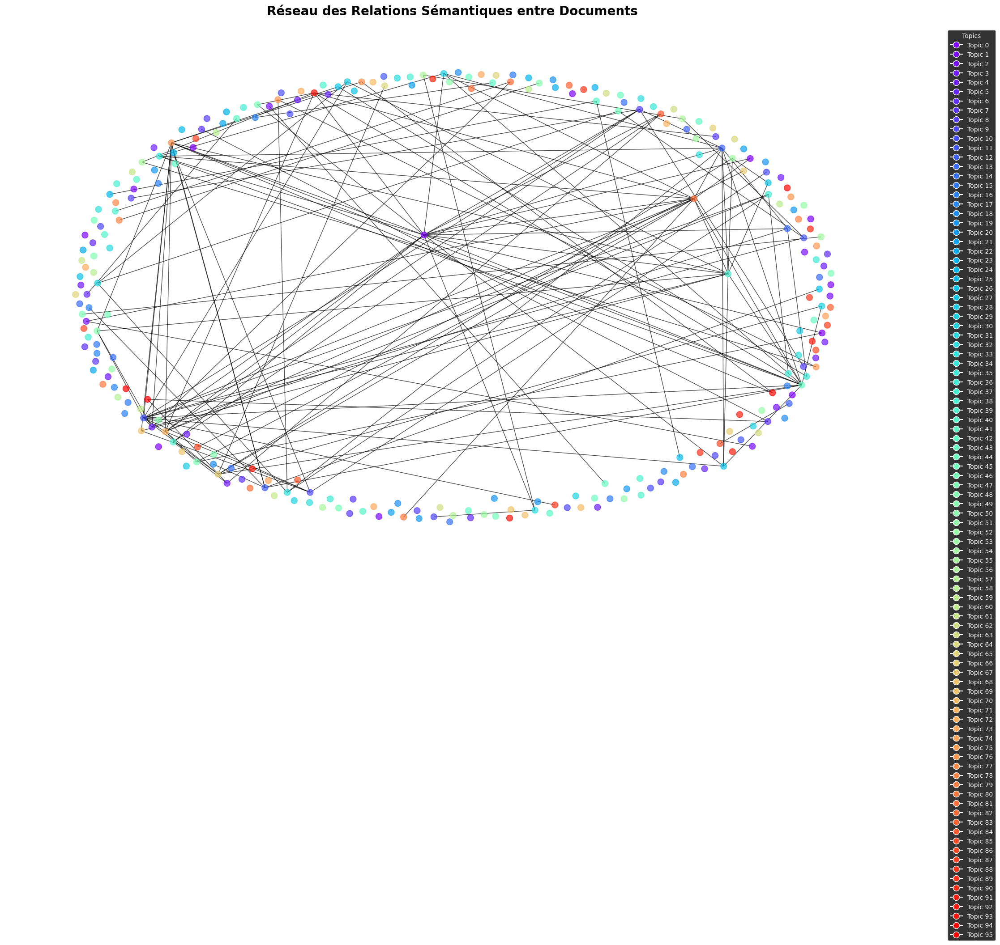


Statistiques du réseau:
Nombre de nœuds: 276
Nombre de connexions: 139
Densité du réseau: 0.004


In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import json

# Section 6 : Graphe des Relations Sémantiques entre Documents
###########################################

print("\n=== Graphe des Relations Sémantiques entre Documents ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les colonnes
if 'topic_keybert' not in processed_df.columns or 'nom' not in processed_df.columns or 'texte' not in processed_df.columns:
    raise KeyError("Erreur : Les colonnes 'topic_keybert', 'nom' ou 'texte' sont absentes dans processed_df.")

# Filtrer les nœuds pour exclure les documents du topic -1
filtered_df = processed_df[processed_df['topic_keybert'] != -1].reset_index(drop=True)
print(f"Nombre de documents après filtrage (excluant topic -1) : {len(filtered_df)}")

# Création du graphe avec les données filtrées
G_filtered = nx.Graph()
embeddings_filtered = topic_model_keybert._extract_embeddings(filtered_df['texte'].tolist())
similarities_filtered = cosine_similarity(embeddings_filtered)

# Diagnostic des similarités pour choisir un seuil
print("Statistiques des similarités:", np.min(similarities_filtered), np.max(similarities_filtered), np.mean(similarities_filtered))

# Ajouter les nœuds
for i in range(len(filtered_df)):
    G_filtered.add_node(i, 
                        space_name=filtered_df['nom'].iloc[i],
                        topic=int(filtered_df['topic_keybert'].iloc[i]))

# Ajouter les arêtes
threshold = 0.65  # Conserver 0.65 (ajuster à 0.6 ou 0.7 si besoin)
print(f"Seuil de similarité utilisé : {threshold}")
for i in range(len(filtered_df)):
    for j in range(i+1, len(filtered_df)):
        if similarities_filtered[i, j] > threshold:
            G_filtered.add_edge(i, j, weight=float(similarities_filtered[i, j]))

# Sauvegarder les données du graphe pour React
nodes_data = [
    {"id": i, "space_name": data["space_name"], "topic": data["topic"]}
    for i, data in G_filtered.nodes(data=True)
]
edges_data = [
    {"source": u, "target": v, "weight": float(data["weight"])}
    for u, v, data in G_filtered.edges(data=True)
]
with open("semantic_network_documents_data.json", "w", encoding="utf-8") as f:
    json.dump({"nodes": nodes_data, "edges": edges_data}, f, ensure_ascii=False, indent=4)
print("Données du graphe sauvegardées dans 'semantic_network_documents_data.json'.")

# Visualisation du réseau
plt.figure(figsize=(20, 12), facecolor='white')
pos = nx.spring_layout(G_filtered, k=3, iterations=100)  # Augmenté iterations pour meilleure convergence

# Colorer les nœuds par topic
topics = [G_filtered.nodes[n]['topic'] for n in G_filtered.nodes()]
unique_topics = list(set(topics))
colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_topics)))

# Dessiner le graphe
nx.draw(G_filtered, pos,
        node_color=[colors[unique_topics.index(t)] for t in topics],
        node_size=100,
        alpha=0.7,
        with_labels=True,  # Désactiver avec False si chevauchement
        labels={i: filtered_df['nom'].iloc[i] for i in range(len(filtered_df))},
        font_size=8,  # Réduit pour éviter le chevauchement
        font_color='black')

# Ajouter la légende
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', 
                              markerfacecolor=colors[i], label=f'Topic {t}',
                              markersize=10)
                   for i, t in enumerate(unique_topics)]
plt.legend(handles=legend_elements, 
           title='Topics',
           bbox_to_anchor=(1.05, 1),
           loc='upper left')

# Titre et configuration finale
plt.title("Réseau des Relations Sémantiques entre Documents",
          pad=20,
          fontsize=20,
          fontweight='bold',
          color='black')

plt.tight_layout()
plt.savefig('semantic_network_documents.png', 
            dpi=300,
            bbox_inches='tight',
            facecolor='white')
plt.show()

# Afficher quelques statistiques sur le réseau
print("\nStatistiques du réseau:")
print(f"Nombre de nœuds: {G_filtered.number_of_nodes()}")
print(f"Nombre de connexions: {G_filtered.number_of_edges()}")
print(f"Densité du réseau: {nx.density(G_filtered):.3f}")

- Chaque document (espace) est représenté par un nœud dans le graphe.

- Chaque document est associé à un topic, indiqué par sa couleur selon une palette rainbow (topics 0 à 68, hors -1).

- Les arêtes sont ajoutées entre les nœuds si la similarité cosinus entre les embeddings des deux documents dépasse un seuil de 0.65.

- Si deux documents (nœuds) sont très similaires (similarité > 0.65), cela signifie qu’ils partagent des sujets proches ou des thématiques communes.

- Ce graphe représente les relations sémantiques entre les documents en utilisant leurs embeddings (générés par topic_model_keybert) et les similarités cosinus. Il visualise les connexions entre documents similaires, les colore par topic, et fournit des statistiques utiles (nombre de nœuds : 276, nombre d’arêtes : 139, densité : 0.004), bien que la visualisation statique avec matplotlib et spring_layout soit limitée par la densité et le nombre d’étiquettes.

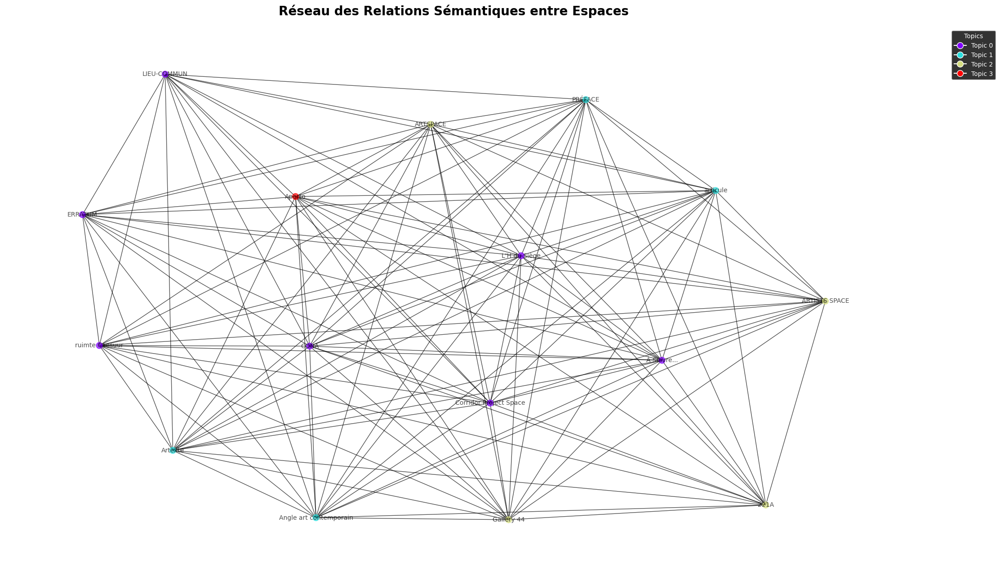


Statistiques du réseau:
Nombre de nœuds: 16
Nombre de connexions: 116
Densité du réseau: 0.967


In [25]:

# Section 6 : Graphe des Relations Sémantiques
###########################################

# Filtrer les nœuds pour exclure les documents du topic -1
filtered_df = processed_df[processed_df['topic'] != -1]

# Création du graphe avec les données filtrées
G_filtered = nx.Graph()
embeddings_filtered = topic_model._extract_embeddings(filtered_df['texte'].tolist())
similarities_filtered = cosine_similarity(embeddings_filtered)

# Ajouter les nœuds
for i, (nom, topic) in enumerate(zip(filtered_df['nom'], filtered_df['topic'])):
    G_filtered.add_node(i, space_name=nom, topic=topic)

# Ajouter les arêtes
threshold = 0.5  # Augmenté pour réduire la densité
for i in range(len(filtered_df)):
    for j in range(i + 1, len(filtered_df)):
        if similarities_filtered[i, j] > threshold:
            G_filtered.add_edge(i, j, weight=similarities_filtered[i, j])

# Supprimer les nœuds isolés (moins de 2 connexions)
isolated_nodes = [node for node, degree in dict(G_filtered.degree()).items() if degree < 50]
G_filtered.remove_nodes_from(isolated_nodes)

# Génération des positions après suppression des nœuds isolés
pos = nx.spring_layout(G_filtered, k=1, iterations=50)

# Vérifier que tous les nœuds dans `pos` sont bien présents dans `G_filtered`
valid_nodes = set(G_filtered.nodes())
pos = {n: pos[n] for n in valid_nodes if n in pos}

# Visualisation du réseau
plt.figure(figsize=(20, 12), facecolor='white')

# Colorer les nœuds par topic
topics = [G_filtered.nodes[n]['topic'] for n in G_filtered.nodes()]
unique_topics = list(set(topics))
colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_topics)))

# Dessiner le graphe
nx.draw(G_filtered, pos,
        node_color=[colors[unique_topics.index(G_filtered.nodes[n]['topic'])] for n in G_filtered.nodes()],
        node_size=100,
        alpha=0.7,
        with_labels=True,
        labels={n: G_filtered.nodes[n]['space_name'] for n in G_filtered.nodes()},
        font_size=10,
        font_color='black')

# Ajouter la légende
legend_elements = [plt.Line2D([0], [0], marker='o', color='w',
                              markerfacecolor=colors[i], label=f'Topic {t}',
                              markersize=10)
                   for i, t in enumerate(unique_topics)]
plt.legend(handles=legend_elements,
           title='Topics',
           bbox_to_anchor=(1.05, 1),
           loc='upper left')

# Titre et configuration finale
plt.title("Réseau des Relations Sémantiques entre Espaces",
          pad=20,
          fontsize=20,
          fontweight='bold',
          color='black')

plt.tight_layout()
plt.savefig('semantic_network.png',
            dpi=300,
            bbox_inches='tight',
            facecolor='white')
plt.show()

# Afficher quelques statistiques sur le réseau
print("\nStatistiques du réseau:")
print(f"Nombre de nœuds: {G_filtered.number_of_nodes()}")
print(f"Nombre de connexions: {G_filtered.number_of_edges()}")
print(f"Densité du réseau: {nx.density(G_filtered):.3f}")


In [29]:
import json

# Construire le dictionnaire des nœuds
nodes_data = [
    {
        "id": int(i),  # Convertir en int standard
        "name": str(G_filtered.nodes[i]["space_name"]),
        "topic": int(G_filtered.nodes[i]["topic"])  # Convertir topic en int
    }
    for i in G_filtered.nodes
]

# Construire le dictionnaire des liens (edges)
edges_data = [
    {
        "source": int(i),  # Convertir en int standard
        "target": int(j),
        "weight": float(G_filtered[i][j]["weight"])  # Convertir en float standard
    }
    for i, j in G_filtered.edges
]

# Créer la structure finale
graph_data = {
    "nodes": nodes_data,
    "links": edges_data
}

# Sauvegarde en JSON
with open("semantic_network.json", "w", encoding="utf-8") as f:
    json.dump(graph_data, f, indent=4, ensure_ascii=False)

print("✅ Fichier JSON enregistré : semantic_network.json")


✅ Fichier JSON enregistré : semantic_network.json



Exemple d'annotations générées :
Thème 0: Based on the given texts and keywords, the extracted topic is:
Thème 1: Artist-run art centers
Thème 2: Based on the context provided, the focus is on:
Thème 3: Alternative Art Spaces
Autres thèmes


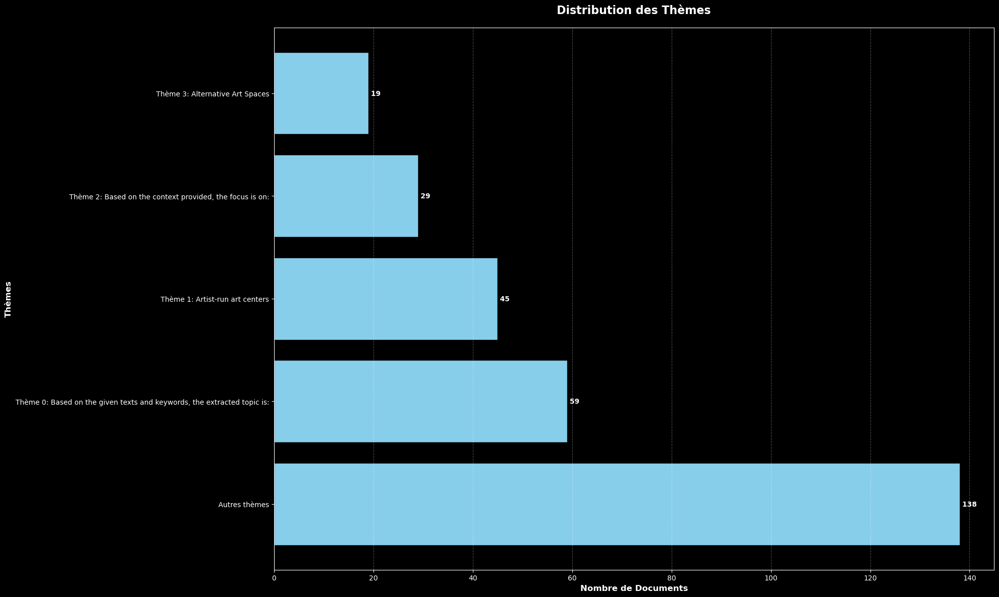

In [30]:
# Section 7 : Annotations et Pipeline
###########################################
def generate_topic_annotations(topic_model, topics):
    """
    Génère des annotations descriptives pour chaque topic
    """
    annotations = {}
    for topic_id in set(topics):
        if topic_id != -1:
            # Obtenir les mots-clés du topic
            keywords = topic_model.get_topic(topic_id)
            # Générer une annotation basée sur les mots-clés principaux
            main_keywords = [word for word, _ in keywords[:3]]
            annotation = " & ".join(main_keywords)
            annotations[topic_id] = f"Thème {topic_id}: {annotation}"
    
    # Ajouter une annotation pour le topic -1 (outliers)
    annotations[-1] = "Autres thèmes"
    return annotations

def topic_annotation_pipeline(new_texts, topic_model, existing_annotations=None):
    """
    Pipeline pour appliquer les annotations à de nouveaux textes
    
    Parameters:
    -----------
    new_texts : list
        Liste des nouveaux textes à analyser
    topic_model : BERTopic
        Modèle BERTopic entraîné
    existing_annotations : dict, optional
        Annotations existantes à réutiliser
        
    Returns:
    --------
    DataFrame avec les résultats de l'analyse
    """
    # Transformer les nouveaux textes
    new_topics, new_probs = topic_model.transform(new_texts)
    
    # Utiliser les annotations existantes ou en générer de nouvelles
    if existing_annotations is None:
        annotations = generate_topic_annotations(topic_model, new_topics)
    else:
        annotations = existing_annotations
    
    # Créer un DataFrame avec les résultats
    results = pd.DataFrame({
        'texte': new_texts,
        'topic': new_topics,
        'annotation': [annotations.get(topic, "Autre") for topic in new_topics],
        'probabilite': [np.max(prob) for prob in new_probs]
    })
    
    return results

# Application des annotations au DataFrame existant
topic_annotations = generate_topic_annotations(topic_model, topics)
processed_df['annotation'] = processed_df['topic'].map(topic_annotations)

# Affichage des résultats
print("\nExemple d'annotations générées :")
for topic_id, annotation in list(topic_annotations.items())[:5]:
    print(f"{annotation}")

# Calculer les comptes d'annotations
annotation_counts = processed_df['annotation'].value_counts()

# Créer une figure avec une taille spécifique
plt.figure(figsize=(20, 12))

# Créer le graphique en barres horizontales
bars = plt.barh(range(len(annotation_counts)), annotation_counts.values, color='skyblue', edgecolor='black')

# Configurer les étiquettes de l'axe y
plt.yticks(range(len(annotation_counts)), annotation_counts.index, fontsize=10)

# Ajouter les valeurs sur les barres
for i, bar in enumerate(bars):
    width = bar.get_width()
    plt.text(width, i, f' {int(width)}', va='center', fontsize=10, fontweight='bold')

# Configurer les titres et labels
plt.title("Distribution des Thèmes", fontsize=16, fontweight='bold', pad=20)
plt.xlabel("Nombre de Documents", fontsize=12, fontweight='bold')
plt.ylabel("Thèmes", fontsize=12, fontweight='bold')

# Ajouter une grille légère
plt.grid(axis='x', linestyle='--', alpha=0.3)

# Ajuster la mise en page
plt.tight_layout()

# Sauvegarder et afficher
plt.savefig('distribution_themes.png', 
            dpi=300, 
            bbox_inches='tight',
            facecolor='white')
plt.show()

# Section des Annotations retenues

In [31]:
# Générer des annotations à partir des topics
topic_annotations = generate_topic_annotations(topic_model, topics)

# Convertir en format adapté pour l'interface
annotations_ui = []
for topic_id, annotation_text in topic_annotations.items():
    if topic_id != -1:  # Exclure les outliers si nécessaire
        color = f"#{random.randint(0, 255):02x}{random.randint(0, 255):02x}{random.randint(0, 255):02x}"
        count = len(processed_df[processed_df['topic'] == topic_id])
        annotations_ui.append({
            "id": int(topic_id),
            "name": annotation_text,
            "color": color,
            "count": count
        })

# Sauvegarder en JSON
with open("annotations.json", "w", encoding="utf-8") as f:
    json.dump(annotations_ui, f, ensure_ascii=False, indent=4)

print("Fichier JSON 'annotations.json' généré avec succès.")

NameError: name 'random' is not defined

In [ ]:
#Enregistrer les annations pour étiqueter" ou classifier les documents
#Enregistrer en json 



In [ ]:
# Section 8 : Export des Résultats
###########################################

# Préparer le DataFrame final avec toutes les informations importantes
final_results = pd.DataFrame({
    'nom_espace': processed_df['nom'],
    'texte': processed_df['texte'],
    'topic': processed_df['topic'],
    'annotation': processed_df['annotation'],
    'probabilite': processed_df['topic_probability']
})

# Ajouter les mots-clés pour chaque espace
keywords_dict = {}
for idx, row in final_results.iterrows():
    if row['topic'] != -1:
        keywords = topic_model.get_topic(row['topic'])
        keywords_dict[idx] = ', '.join([word for word, _ in keywords[:5]])
    else:
        keywords_dict[idx] = 'Non classifié'

final_results['mots_cles'] = pd.Series(keywords_dict)

# Sauvegarder les résultats
final_results.to_excel("resultats_complets.xlsx", index=False)
final_results[['nom_espace', 'topic', 'annotation', 'mots_cles']].to_csv("resume_classification.csv", index=False)

# Afficher un résumé détaillé avec pandas
print("\n=== RÉSUMÉ DE L'ANALYSE ===")
print(f"\nNombre total d'espaces analysés : {len(final_results)}")
print(f"Nombre de topics identifiés : {len(topic_annotations)}")

print("\n=== DISTRIBUTION DES TOPICS ===")
topic_dist = final_results['topic'].value_counts().sort_index()
display(topic_dist.to_frame(name='Nombre d\'espaces'))

print("\n=== APERÇU DES RÉSULTATS PAR TOPIC ===")
for topic in sorted(final_results['topic'].unique()):
    if topic != -1:
        print(f"\nTopic {topic}:")
        subset = final_results[final_results['topic'] == topic][['nom_espace', 'annotation', 'mots_cles']]
        display(subset.head(3))
        print("-" * 100)

# Créer un résumé statistique
summary_stats = pd.DataFrame({
    'Métrique': [
        'Nombre total d\'espaces',
        'Nombre de topics',
        'Espaces non classifiés',
        'Topic le plus fréquent',
        'Taille moyenne par topic'
    ],
    'Valeur': [
        len(final_results),
        len(topic_annotations) - 1,  # -1 pour exclure le topic -1
        len(final_results[final_results['topic'] == -1]),
        f"Topic {topic_dist.index[0]} ({topic_dist.iloc[0]} espaces)",
        f"{len(final_results) / (len(topic_annotations) - 1):.1f} espaces"
    ]
})

print("\n=== STATISTIQUES GLOBALES ===")
display(summary_stats)

# Sauvegarder le modèle
import joblib
joblib.dump(topic_model, 'model_bertopic.pkl')
print("\nModèle sauvegardé sous 'model_bertopic.pkl'")


=== RÉSUMÉ DE L'ANALYSE ===

Nombre total d'espaces analysés : 280
Nombre de topics identifiés : 9

=== DISTRIBUTION DES TOPICS ===


,Nombre d'espaces
topic,
-1,105
0,48
1,32
2,30
3,17
4,15
5,12
6,11
7,10



=== APERÇU DES RÉSULTATS PAR TOPIC ===

Topic 0:


,nom_espace,annotation,mots_cles
1,/ 77,Thème 0: events & media & cultural,"events, media, cultural, platform, local"
8,KINGS Artist Run,Thème 0: events & media & cultural,"events, media, cultural, platform, local"
11,Artpool,Thème 0: events & media & cultural,"events, media, cultural, platform, local"


----------------------------------------------------------------------------------------------------

Topic 1:


,nom_espace,annotation,mots_cles
2,Immanence,Thème 1: activity & poetry & research,"activity, poetry, research, milan, activities"
3,Lieu d'exposition en voie de déplacement (LEVD),Thème 1: activity & poetry & research,"activity, poetry, research, milan, activities"
27,Museo de Arte Abstracto Español,Thème 1: activity & poetry & research,"activity, poetry, research, milan, activities"


----------------------------------------------------------------------------------------------------

Topic 2:


,nom_espace,annotation,mots_cles
7,H+,Thème 2: berlin & wall & strategy,"berlin, wall, strategy, different, future"
14,Nürnberger Eck,Thème 2: berlin & wall & strategy,"berlin, wall, strategy, different, future"
25,Bell Street Project Space,Thème 2: berlin & wall & strategy,"berlin, wall, strategy, different, future"


----------------------------------------------------------------------------------------------------

Topic 3:


,nom_espace,annotation,mots_cles
13,GERTRUDE CONTEMPORARY,Thème 3: printed & centre & organization,"printed, centre, organization, community, profit"
91,"Printed Matter, Inc.",Thème 3: printed & centre & organization,"printed, centre, organization, community, profit"
109,Arprim,Thème 3: printed & centre & organization,"printed, centre, organization, community, profit"


----------------------------------------------------------------------------------------------------

Topic 4:


,nom_espace,annotation,mots_cles
35,Angle art contemporain,Thème 4: family & centre & france,"family, centre, france, residences, atelier"
36,Triangle,Thème 4: family & centre & france,"family, centre, france, residences, atelier"
63,Diagonale,Thème 4: family & centre & france,"family, centre, france, residences, atelier"


----------------------------------------------------------------------------------------------------

Topic 5:


,nom_espace,annotation,mots_cles
5,BLINDSIDE,Thème 5: fashion & john & events,"fashion, john, events, books, performance"
16,TCB,Thème 5: fashion & john & events,"fashion, john, events, books, performance"
19,West Space,Thème 5: fashion & john & events,"fashion, john, events, books, performance"


----------------------------------------------------------------------------------------------------

Topic 6:


,nom_espace,annotation,mots_cles
34,Open Space,Thème 6: managed & diversity & opening,"managed, diversity, opening, performance, vict..."
57,Espace 29,Thème 6: managed & diversity & opening,"managed, diversity, opening, performance, vict..."
76,Wohnmaschine,Thème 6: managed & diversity & opening,"managed, diversity, opening, performance, vict..."


----------------------------------------------------------------------------------------------------

Topic 7:


,nom_espace,annotation,mots_cles
6,Rogertator,Thème 7: programming & pieces & charlie,"programming, pieces, charlie, cultural, jean"
9,Quellkollektiv,Thème 7: programming & pieces & charlie,"programming, pieces, charlie, cultural, jean"
31,Néon,Thème 7: programming & pieces & charlie,"programming, pieces, charlie, cultural, jean"


----------------------------------------------------------------------------------------------------

=== STATISTIQUES GLOBALES ===


,Métrique,Valeur
0,Nombre total d'espaces,280
1,Nombre de topics,8
2,Espaces non classifiés,105
3,Topic le plus fréquent,Topic -1 (105 espaces)
4,Taille moyenne par topic,35.0 espaces



Modèle sauvegardé sous 'model_bertopic.pkl'
